In [1]:
%load_ext autoreload
%autoreload 2

In [13]:
import torch
import numpy as np
import os
import json
from PIL import Image
from IPython.display import display
from pytorch3d.io import load_obj, save_obj
from pytorch3d.structures import Meshes
import sys

os.environ['CUDA_LAUNCH_BLOCKING'] = "0" 
sys.path.insert(0, os.path.join(os.getcwd(), ".."))

from gaussian_renderer import render

device = "cuda:0"

output_dir = os.path.join("./", "outputs", "test_gaussian_shells_snapshotpeople")
data_dir = os.path.join(os.pardir, "data", "people_snapshot", "male-1-plaza")


## Define Gaussian and SMPL

In [4]:
NUM_SHELLS = 5
OFFSET_LEN = 0.03

In [14]:
from deformer.smpl_deformer import smpl_init_kwargs
from scene.gaussian_deformable_model import GaussianModel

model_root = os.path.join("..", "assets")
model_type = "smpl"
base_shell_path = os.path.join(model_root, model_type, "smpl_uv_no_hands_feet_ear.obj")

smpl_init_kwargs = smpl_init_kwargs.copy()
smpl_init_kwargs["gender"] = "male"
with open(os.path.join(data_dir, "cameras.json"), "r") as f:
    loaded_json = json.load(f)
frame_idx = 0

smpl_can_params = None
# body_pose = torch.tensor(loaded_json[f"{frame_idx:04d}.png"]["body_pose"], dtype=torch.float32).reshape(1, -1).to(device)
# betas = torch.tensor(loaded_json[f"{frame_idx:04d}.png"]["betas"], dtype=torch.float32).reshape(1, -1).to(device)
# # global_orient = torch.tensor(loaded_json[f"{frame_idx:04d}.png"]["global_orient"], dtype=torch.float32).to(device)
# # transl = torch.tensor(loaded_json[f"{frame_idx:04d}.png"]["transl"], dtype=torch.float32).reshape(1, 3).to(device)
# smpl_can_params = {
#     "betas": betas,
#     "body_pose": body_pose,
#     "global_orient": torch.zeros(1, 3).to(device),
#     "transl": torch.zeros(1, 3).to(device),
# }
gaussians = GaussianModel(base_shell_path,
                          sh_degree=3,
                          num_shells=NUM_SHELLS,
                          offset_len=OFFSET_LEN,
                          res=1024,
                          smpl_init_kwargs=smpl_init_kwargs,
                          smpl_can_params=smpl_can_params,
                          device=device)

Generating points for shell 1
Generating points for shell 2
Generating points for shell 3
Generating points for shell 4


In [15]:
gaussians.save_ply(os.path.join(output_dir, "./input.ply"))

### debugging camera transformation

In [ ]:
from pytorch3d.io import save_ply

# transform externally with global_orient and transl
frame_idx = 69

# Load camera parameters
with open(os.path.join(data_dir, "cameras.json"), "r") as f:
    loaded_json = json.load(f)
body_pose = torch.tensor(loaded_json[f"{frame_idx:04d}.png"]["body_pose"], dtype=torch.float32).reshape(1, -1).to(device)
betas = torch.tensor(loaded_json[f"{frame_idx:04d}.png"]["betas"], dtype=torch.float32).reshape(1, -1).to(device)
global_orient = torch.tensor(loaded_json[f"{frame_idx:04d}.png"]["global_orient"], dtype=torch.float32).to(device)
transl = torch.tensor(loaded_json[f"{frame_idx:04d}.png"]["transl"], dtype=torch.float32).reshape(1, 3).to(device)

# If I only apply translation externally, and use the global_orient to rotate the vertices, the result is correct.
# Is there a shift lbs transformation?
with torch.no_grad():
    output = smpl_male(betas=betas,
                       expression=None,
                       body_pose=body_pose,
                       global_orient=global_orient[None],
                       transl=transl,
                       return_verts=True,
                       return_full_pose=True,                       
                    )
v_debug = output.vertices.detach()[0]
global_transform = output.transform_mat[:, 0]  # (1, 4, 4)


In [ ]:
# If I only apply translation externally, and use the global_orient to rotate the vertices, the result is correct.
# Is there a shift lbs transformation?
with torch.no_grad():
    output = smpl_male(betas=betas,
                       expression=None,
                       body_pose=body_pose,                     
                       return_verts=True,
                       return_full_pose=True,                       
                    )
v_debug_d = output.vertices.detach()

# below is the output.rel_transf for the first joint
transform_mat = global_transform
v_debug_d = torch.cat([v_debug_d, torch.ones_like(v_debug_d[...,:1])], dim=-1) @ transform_mat.transpose(1,2)
v_debug_d = v_debug_d[0, ..., :3] + transl

save_ply("./debug.ply", v_debug_d)
print("Test passed:", np.allclose(v_debug_d, v_debug, atol=1e-4))

## Training

### Set up camera for rendering

In [7]:
import numpy as np
import PIL.Image as pil_img
from torch import nn
from scene.cameras import Camera
from utils.graphics_utils import getWorld2View2, getProjectionMatrix

class Camera(nn.Module):
    def __init__(self, 
                 R, T, FoVx, FoVy, 
                 # image, gt_alpha_mask,
                 img_width, img_height,
                 trans=np.array([0.0, 0.0, 0.0]), scale=1.0, data_device = "cuda"
                 ):
        super(Camera, self).__init__()

        self.R = R
        self.T = T
        self.FoVx = FoVx
        self.FoVy = FoVy

        try:
            self.data_device = torch.device(data_device)
        except Exception as e:
            print(e)
            print(f"[Warning] Custom device {data_device} failed, fallback to default cuda device" )
            self.data_device = torch.device("cuda")

        self.image_width = img_width
        self.image_height = img_height

        self.zfar = 100.0
        self.znear = 0.01

        self.trans = trans
        self.scale = scale

        self.world_view_transform = torch.tensor(getWorld2View2(R, T, trans, scale)).transpose(0, 1).to(self.data_device)
        self.projection_matrix = getProjectionMatrix(znear=self.znear, zfar=self.zfar, fovX=self.FoVx, fovY=self.FoVy).transpose(0,1).to(self.data_device)
        self.full_proj_transform = (self.world_view_transform.unsqueeze(0).bmm(self.projection_matrix.unsqueeze(0))).squeeze(0)
        self.camera_center = self.world_view_transform.inverse()[3, :3]

In [8]:
# Load camera parameters
with open(os.path.join(data_dir, "cameras.json"), "r") as f:
    loaded_json = json.load(f)
    
# how many frames in the sequence
num_frames = 0
while True:
    if f"{num_frames:04d}.png" not in loaded_json:
        break
    num_frames = num_frames + 1
cam2world_loaded = np.zeros((num_frames, 4, 4))
for frame_idx in range(num_frames):
    cam2world_loaded[frame_idx] = np.array(loaded_json[f"{frame_idx:04d}.png"]["cam2world"]).reshape(4, 4)    


img_width, img_height = pil_img.open(os.path.join(data_dir, "images", "0000.png")).size
FovX = loaded_json['fovx']
FovY = loaded_json['fovy']

In [9]:
# Combine body transl and rotation to camera extrinsic
world2cam = torch.tensor(cam2world_loaded, dtype=torch.float32).inverse()

# frame_idx = 0
# body_pose = torch.tensor(loaded_json[f"{frame_idx:04d}.png"]["body_pose"], dtype=torch.float32).reshape(1, -1).to(device)
# betas = torch.tensor(loaded_json[f"{frame_idx:04d}.png"]["betas"], dtype=torch.float32).reshape(1, -1).to(device)

# for frame_idx in range(num_frames):
#     global_orient = torch.tensor(loaded_json[f"{frame_idx:04d}.png"]["global_orient"]).to(device)
#     transl = torch.tensor(loaded_json[f"{frame_idx:04d}.png"]["transl"]).to(device)
    
#     output = smpl_male(betas=betas,
#                        expression=None,
#                        body_pose=body_pose,
#                        global_orient=global_orient[None],
#                        transl=transl[None],
#                        return_verts=False
#                     )
#     transf = output.transform_mat[:, 0]
#     transf[0, :3, 3] += transl
#     world2cam[frame_idx:frame_idx+1] = world2cam[frame_idx:frame_idx+1] @ transf.cpu()

world2cam = world2cam.numpy()

### Initialize Gaussians and visualize to debug

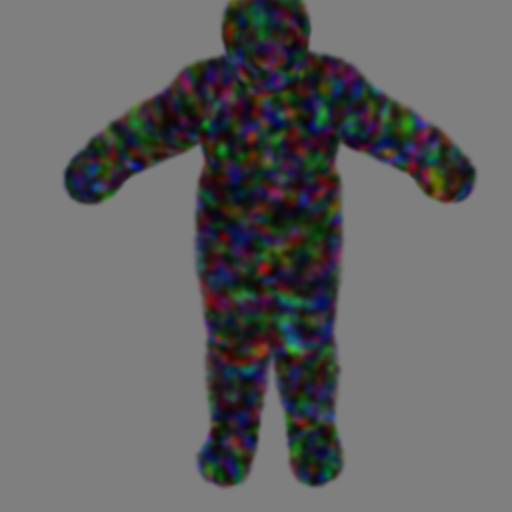

In [16]:
bg_color = [0.5, 0.5, 0.5]
background = torch.tensor(bg_color, dtype=torch.float32, device=gaussians.get_xyz().device)

class PipelineParams():
    def __init__(self):
        self.convert_SHs_python = True
        self.compute_cov3D_python = False
        self.debug = False


pipeline = PipelineParams()
cam_id = 0
camera = Camera(world2cam[cam_id][:3,:3].T, world2cam[cam_id][:3, 3], FovX, FovY, 512, 512, data_device=background.device)
smpl_params = {}
smpl_params["body_pose"] = torch.tensor(loaded_json[f"{cam_id:04d}.png"]["body_pose"], dtype=torch.float32).reshape(1, -1).to(device)
smpl_params["betas"] = torch.tensor(loaded_json[f"{cam_id:04d}.png"]["betas"], dtype=torch.float32).reshape(1, -1).to(device)
smpl_params["global_orient"] = torch.tensor(loaded_json[f"{cam_id:04d}.png"]["global_orient"]).reshape(1, -1).to(device)
smpl_params["transl"] = torch.tensor(loaded_json[f"{cam_id:04d}.png"]["transl"]).reshape(1, -1).to(device)

with torch.no_grad():
    out = render(camera, gaussians, pipeline, background, deformation_kwargs=smpl_params)
    rendering = out["render"]

im = (np.uint8(rendering.detach().permute(1,2,0).cpu().numpy()*255))
display(Image.fromarray(im))

### Load data

In [17]:
from natsort import natsorted
from glob import glob


img_dir = natsorted(glob(os.path.join(data_dir, "images", "*.png")))
mask_dir = natsorted(glob(os.path.join(data_dir, "masks", "*.png")))

with torch.no_grad():
    images_all = []
    _gif_frames = []
    smpl_params_all = []
    for i in range(0, num_frames):
        img_loaded = Image.open(os.path.join(data_dir, "images", f"{i:04d}.png"))
        mask_loaded = Image.open(os.path.join(data_dir, "masks", f"{i:04d}.png"))
        img_loaded = img_loaded.resize((512, 512))
        mask_loaded = mask_loaded.resize((512, 512))
        ref = np.concatenate([np.array(img_loaded), np.array(mask_loaded)[...,None]], axis=-1)    
        # gray background
        ref = np.uint8((ref[:,:,:3] * (ref[:,:,3:]/255)) + (1-ref[:,:,3:]/255)*127)            
        # load smpl parameters
        smpl_params = {}
        smpl_params["body_pose"] = torch.tensor(loaded_json[f"{i:04d}.png"]["body_pose"], dtype=torch.float32).reshape(1, -1).to(device)
        smpl_params["betas"] = torch.tensor(loaded_json[f"{i:04d}.png"]["betas"], dtype=torch.float32).reshape(1, -1).to(device)
        smpl_params["global_orient"] = torch.tensor(loaded_json[f"{i:04d}.png"]["global_orient"]).reshape(1, -1).to(device)
        smpl_params["transl"] = torch.tensor(loaded_json[f"{i:04d}.png"]["transl"]).reshape(1, -1).to(device)
        if i % 2 == 0:
            camera = Camera(world2cam[i][:3,:3].T, world2cam[i][:3, 3], FovX, FovY, 512, 512, data_device="cuda")
            out = render(camera, gaussians, pipeline, background, deformation_kwargs=smpl_params)
            rendering = out["render"]
            im = (np.uint8(rendering.detach().permute(1,2,0).cpu().numpy()*255))
            im = im//2 + ref//2
            _gif_frames.append(Image.fromarray(im))
        images_all.append(ref)
        smpl_params_all.append(smpl_params)

_gif_frames[0].save(os.path.join(output_dir, 'training_data.gif'), append_images=_gif_frames[1:], save_all=True, duration=100, loop=0)
del _gif_frames

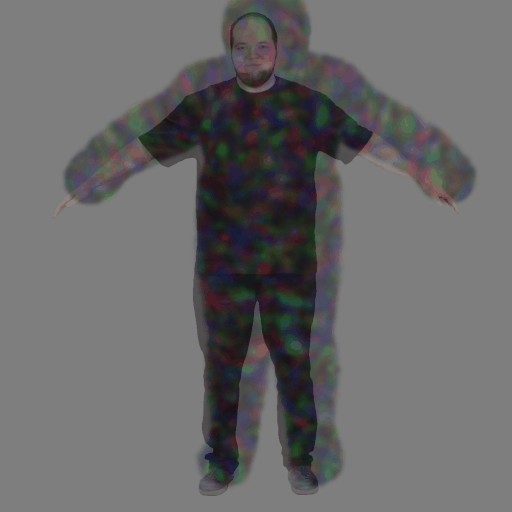

In [18]:
import IPython.display
IPython.display.Image(open(os.path.join(output_dir, 'training_data.gif'),'rb').read())

In [ ]:
from IPython.display import display
from PIL import Image
import random
from utils.loss_utils import l1_loss, ssim
from PIL import Image
from tqdm import tqdm

class OptimizationParams:    
    feature_lr = 0.0025
    percent_dense = 0
    position_lr_init = 0.0
    position_lr_final = 0.0
    position_lr_delay_mult = 0.0
    position_lr_max_steps = 1
    
            
opt  = OptimizationParams()

gaussians.optimizer = torch.optim.Adam([{'params': gaussians._texture_planes, 'lr': opt.feature_lr, "name": "texture_planes"}],
    lr=0.0, betas=(0.9, 0.999), eps=1e-08, weight_decay=0, amsgrad=False)

# list_eval = [63,60,9,15,107,56,99,108,1,4,70,38,27,51,17,18,20,97,93,85,35,114,5,119,19,87,82,62,84,64,28,98,80,94,106,86]
# list_train = [i for i in range(num_frames) if i not in list_eval]
list_train = [0]

iterations = 50000
progress_bar = tqdm(total=iterations, desc="Training")
for iteration in range(iterations):
    idx = random.choice(list_train)
    # gaussians.update_learning_rate(iteration)

    camera = Camera(world2cam[idx][:3,:3].T, world2cam[idx][:3, 3], FovX, FovY, img_width=512, img_height=512, data_device=gaussians.get_xyz.device)
    out = render(camera, gaussians, pipeline, background, smpl_params_all[idx])
    rendering = out['render']
    viewspace_point_tensor = out['viewspace_points']
    visibility_filter = out['visibility_filter']
    radii = out['radii']        

    ref = images_all[idx]
    ref = ((torch.from_numpy(ref).cuda()/255)).permute(2,0,1).unsqueeze(0)

    
    loss = (1.0 - 0.2) * l1_loss(rendering, ref) + 0.2 * (1.0 - ssim(rendering, ref))        
    loss.backward()
    
    gaussians.optimizer.step()
    gaussians.optimizer.zero_grad(set_to_none = True)

    progress_bar.set_description(f"Epoch [{iteration}], Loss: {loss.item():.5f}")
    progress_bar.update(1)        

    if iteration % 5000 ==0:                          
        with torch.no_grad():
            out = render(camera, gaussians, pipeline, background)
            rendering = out['render']
            im2 = gaussians.opacity_activation(gaussians._opacity[0].flip(1).repeat(1,1,3))
            im2 = (np.uint8(im2.clone().detach().cpu().numpy()*255))
            im = (np.uint8(rendering.clone().detach().permute(1,2,0).cpu().numpy()*255))
            im = Image.fromarray(im)
            display(im)            

## Save results

In [ ]:
# Save results
import pickle
with torch.no_grad():    
    # Save the object to a pickle file
    with open(os.path.join(output_dir, "point_list.pkl"), "wb") as f:
        pickle.dump(point_list, f)
    with open(os.path.join(output_dir, "gaussians.pkl"), "wb") as f:
        pickle.dump(gaussians, f)
    np.savez(os.path.join(output_dir, "cameras"), world2cam=world2cam, FovX=FovX, FovY=FovY)
    gaussians.save_ply(os.path.join(output_dir, "point_cloud", "iteration_%d" % iterations, "point_cloud.ply"), )
    

In [ ]:
# gaussians.save_to_images(os.path.join(output_dir, "textures", "iteration_%d" % iterations))

## Evaluation PSNR test

In [ ]:
# import torch.nn.functional as F

# def compute_psnr(image1, image2, max_pixel_value=1.0):
#     mse = F.mse_loss(image1, image2)
#     psnr = 20 * torch.log10(max_pixel_value / torch.sqrt(mse))
#     return psnr

# total_psnr = 0
# # x= random.choice(list_eval)
# # for x in range(120):
# for idx in list_eval:
#     img_loaded = Image.open(img_dir[idx]) 
#     img_loaded = img_loaded.resize((512, 512))
#     ref = np.array(img_loaded)
#     if ref.shape[2] == 4:
#         ref = np.uint8((ref[:,:,:3] * (ref[:,:,3:]/255)) + (1-ref[:,:,3:]/255)*127)
#     ref = ((torch.from_numpy(ref).cuda()/255)).permute(2,0,1) #.unsqueeze(0)
#     camera  = Camera(world2cam[idx][:3,:3].T, world2cam[idx][:3, 3], FovX, FovY, img_width=512, img_height=512, data_device="cuda")
#     out = render(camera, gaussians, pipeline, background)
#     rendering = out['render']
#     psnr_value = compute_psnr(ref, rendering)
#     total_psnr += psnr_value.item()

# average_psnr = total_psnr / len(list_eval)
# print(f"Average PSNR: {average_psnr} dB")